In [133]:
import pandas as pd
from math import exp
from numpy import *
import numpy as np
from random import normalvariate#正态分布
from datetime import datetime
import csv
from collections import Counter
import matplotlib.pyplot as plt
## 所有的变量Train_group,external_factor都是整理好的sample，只有Matrix是未整理好的。
#转换成27*27
def transfer_729(A):
    B1=np.zeros([729])    
    for i in range(354):
        B1[index_road[i]]=A[i]
    B1=B1.reshape([27,27])
    return B1
#转换成354
def transfer_354(A):
    B1=np.zeros([354])
    A=np.array(A).reshape([729])
    for i in range(354):
        B1[i]=A[index_road[i]]
    return B1
index_road=pd.DataFrame(pd.read_csv("index_road.csv"))
index_road=np.array(index_road)
# # 导入数据集的sample_index
# X=np.load('sample_Xmultisetp.npy')
# Y=np.load('sample_Ymultisetp.npy')

# load the predicted results
#fine-grained risk prediction
NUM = 85
Predicted_results_1task=np.load('GCN_results_07/task_1_0814_4800_100_18_9L_456_'+str(NUM)+'.npy') 
#coarse-grained risk prediction
Predicted_results_3task=np.load('GCN_results_07/task_3_0814_4800_100_18_9L_456_'+str(NUM)+'.npy') 
# Load the groundtruth
true_labels=np.load('train_data_1210/true_labels.npy')
true_labels_3=np.load('train_data_1210/true_labels_3.npy') 
Cluster_results = np.load('Cluster_18_6.npy')


In [134]:
## 简单评估准确率
K = 10
Total_time = 6
Total_acc_region = 0
Correct_num = 0
for i in range(len(Predicted_results_1task)):
    Predicted = list(np.argsort(-Predicted_results_1task[i,0,:,0])[0:K])
    True_label = list(np.flatnonzero(true_labels[i,:,0]>0))
    Total_acc_region = Total_acc_region + len(True_label)
    Acc_cross = list(set(Predicted).intersection(set(True_label)))
    Correct_num = Correct_num + len(Acc_cross)
Accuracy = Correct_num/Total_acc_region
print(Accuracy)

0.45535714285714285


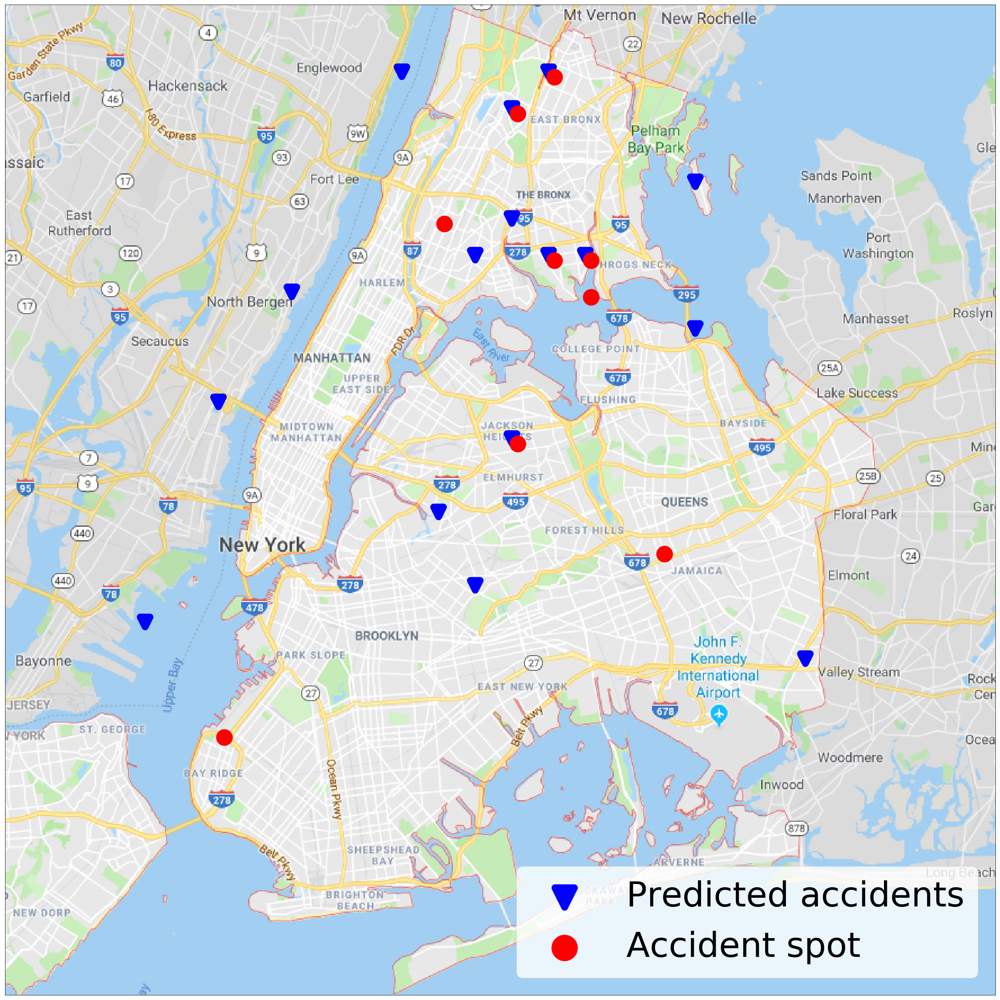

0.5555555555555556 0.5555555555555556


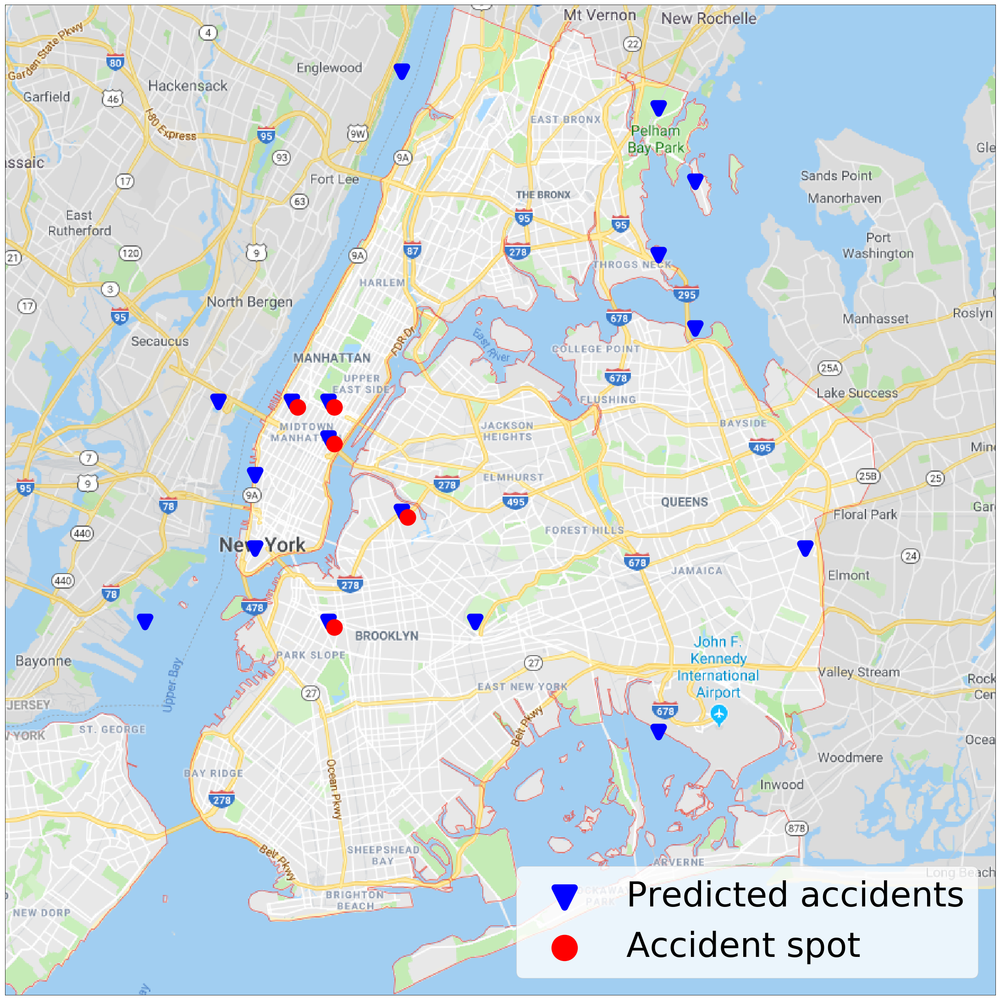

1.0 1.0


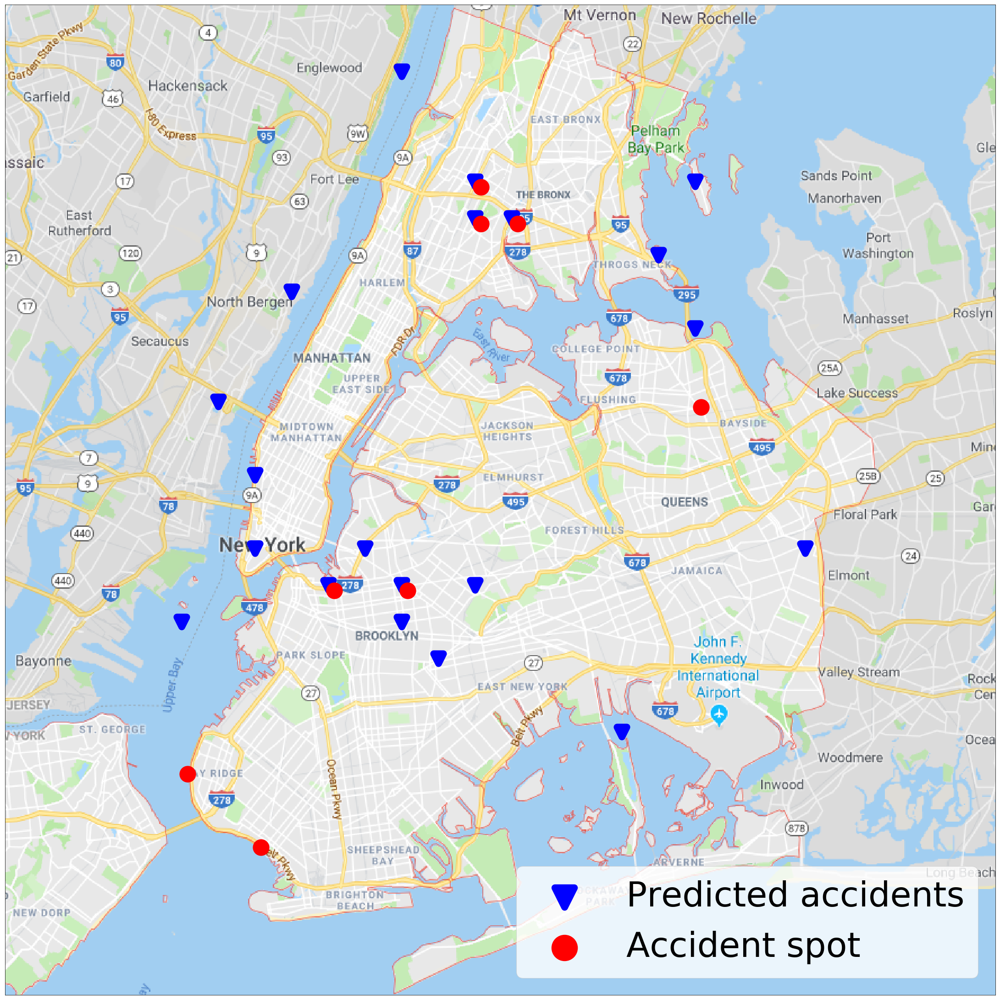

0.625 0.75


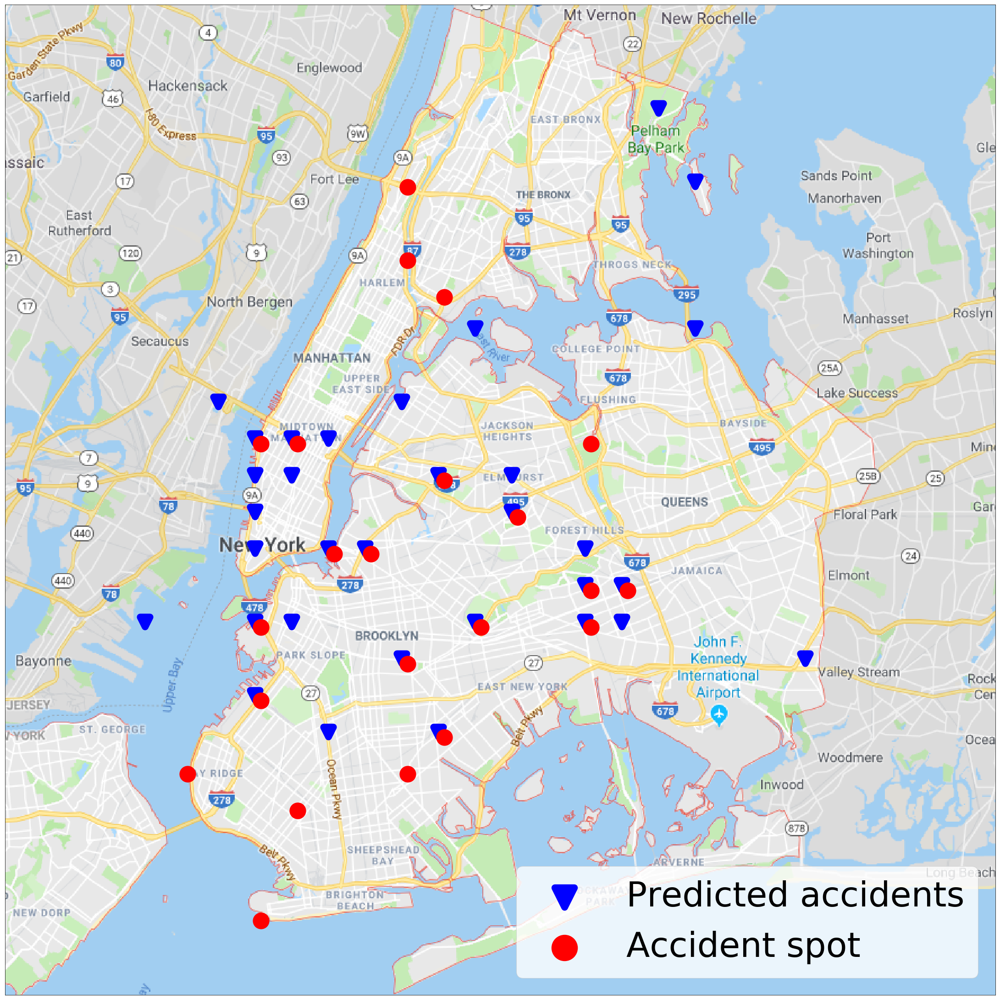

0.6363636363636364 0.5454545454545454


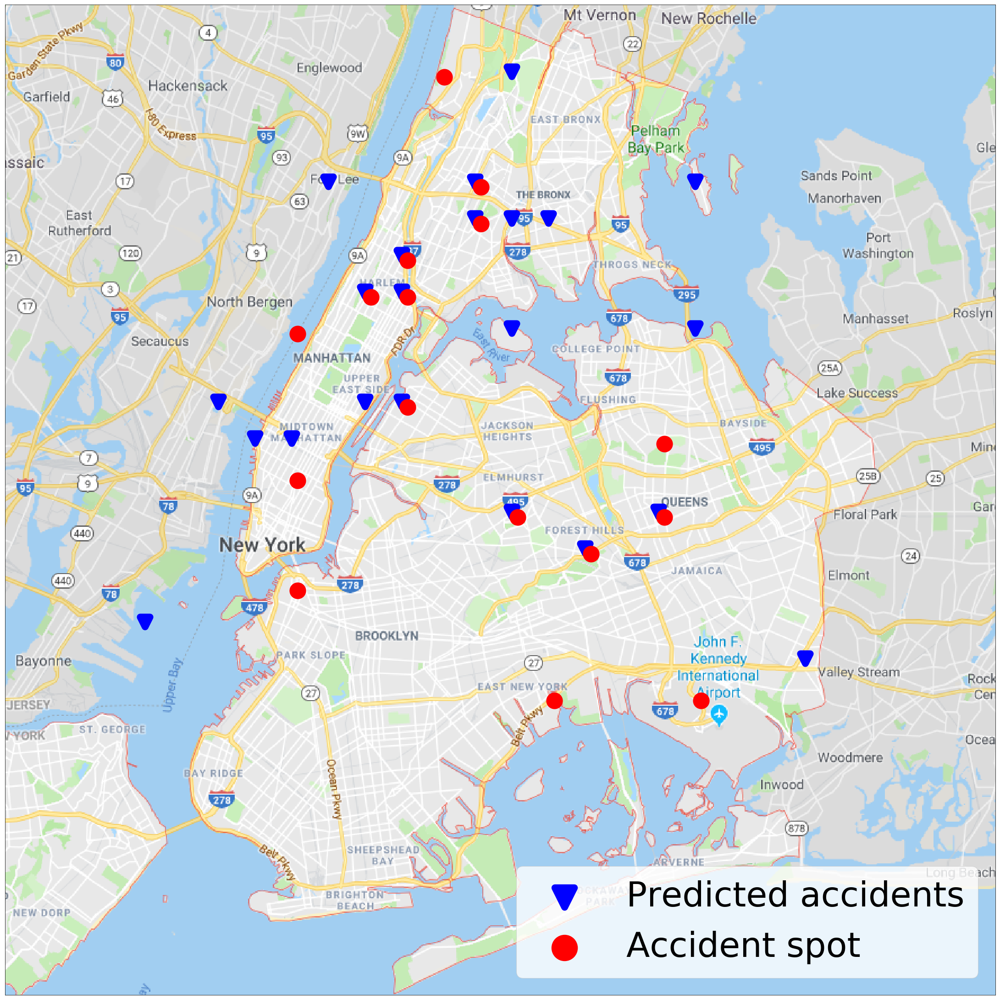

0.5625 0.75


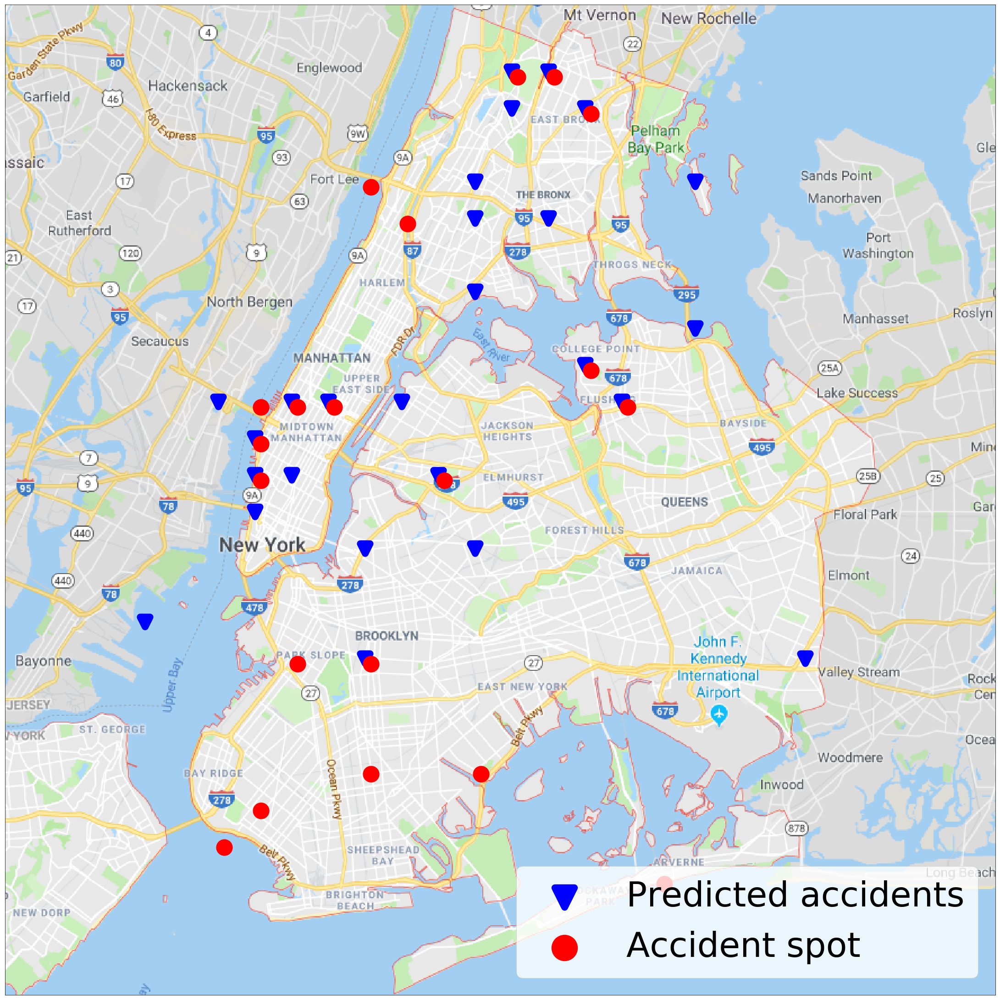

0.55 0.4


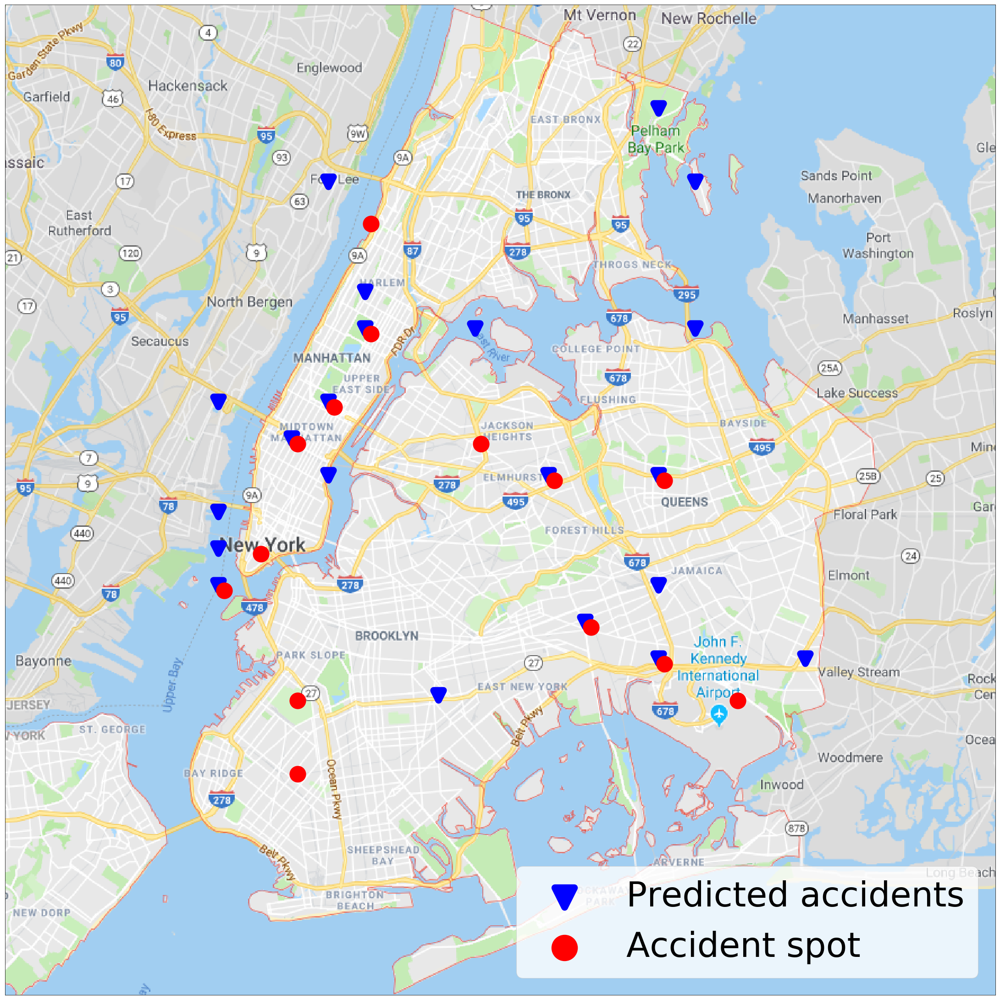

0.5714285714285714 0.6428571428571429


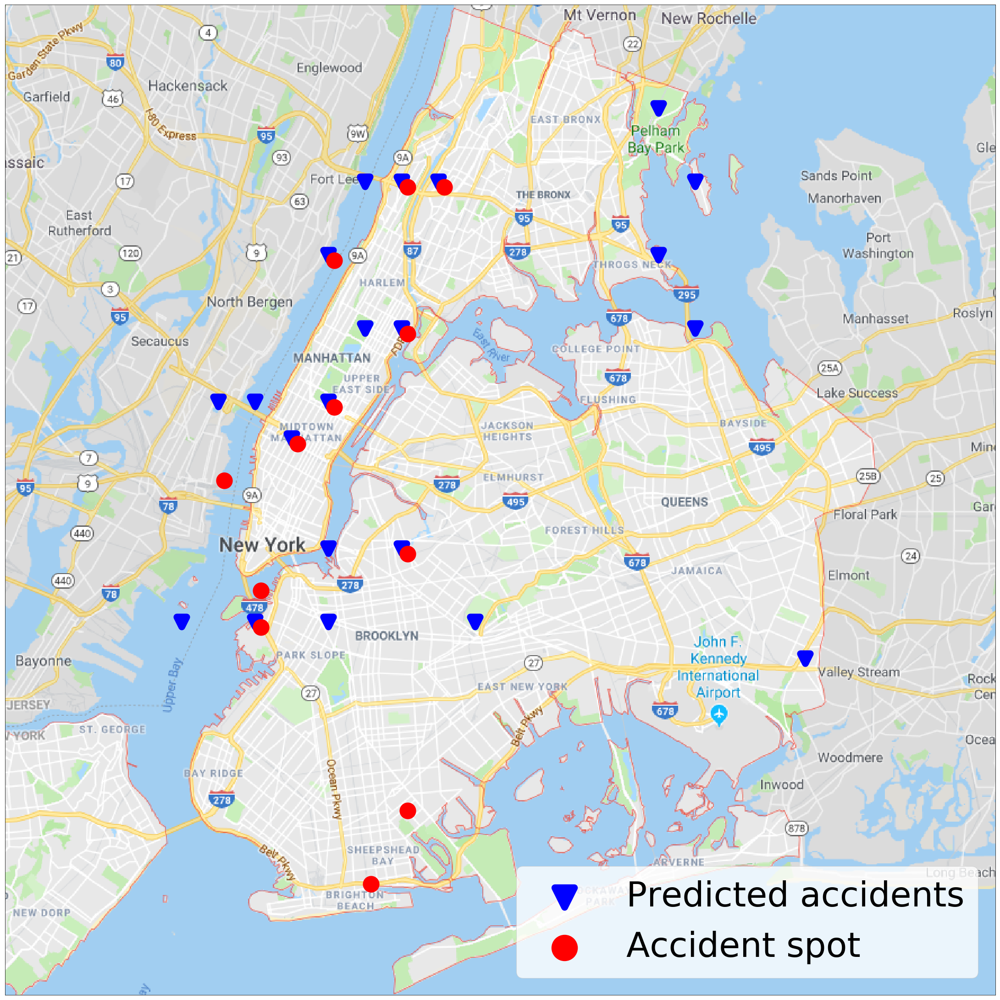

0.6666666666666666 0.8333333333333334


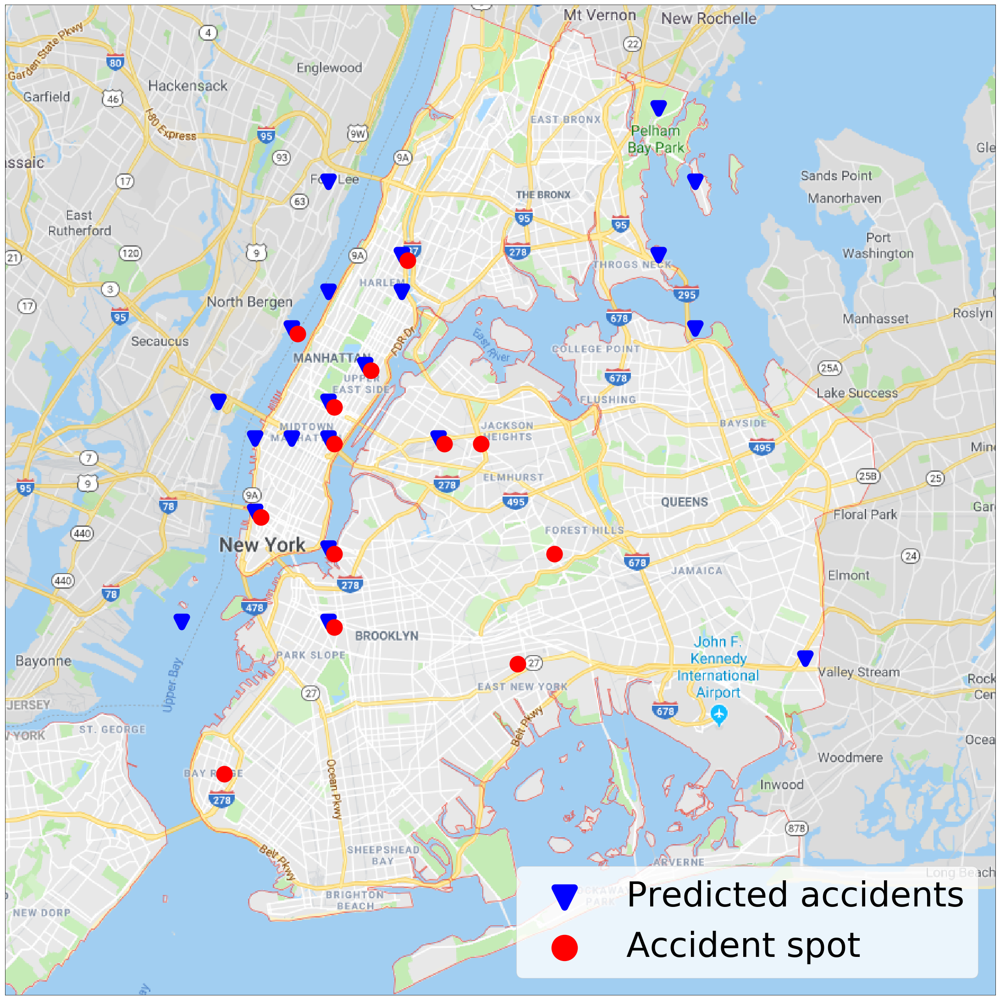

0.6923076923076923 0.7692307692307693


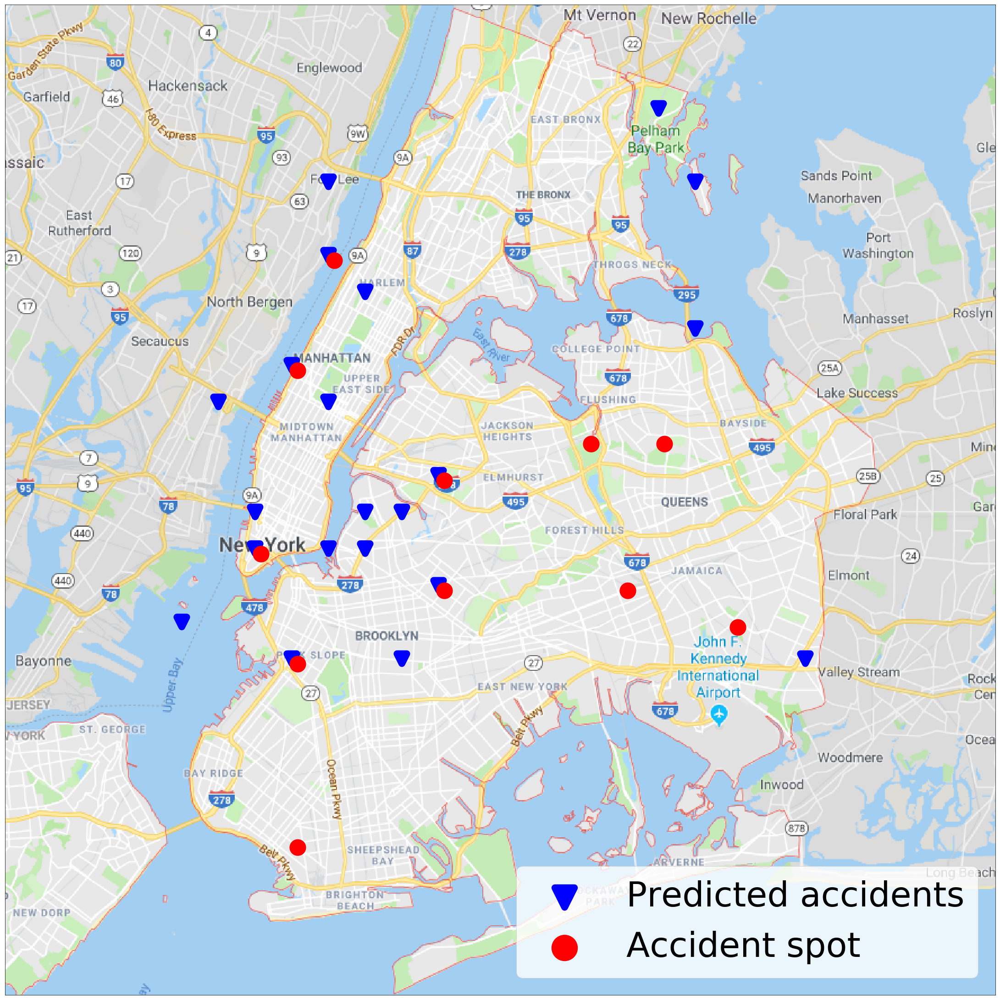

0.5454545454545454 0.9090909090909091


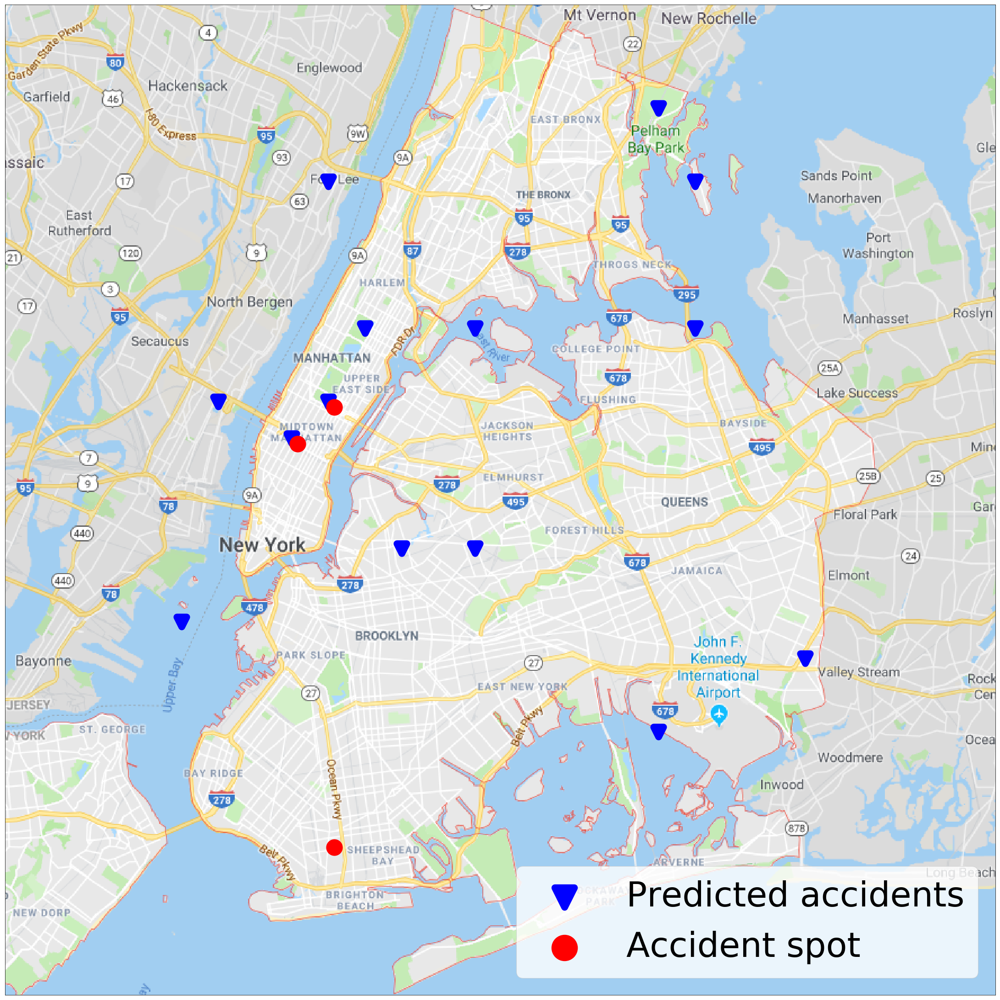

0.6666666666666666 1.0


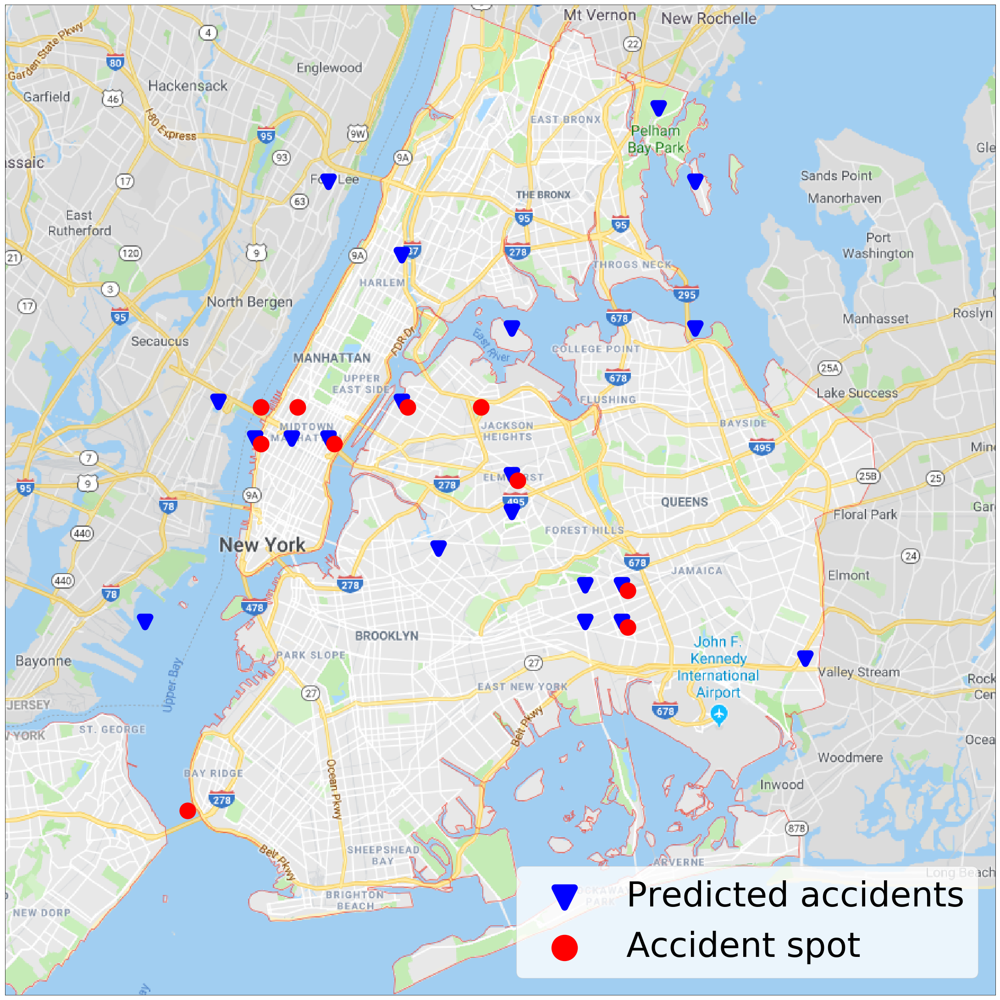

0.6 0.6


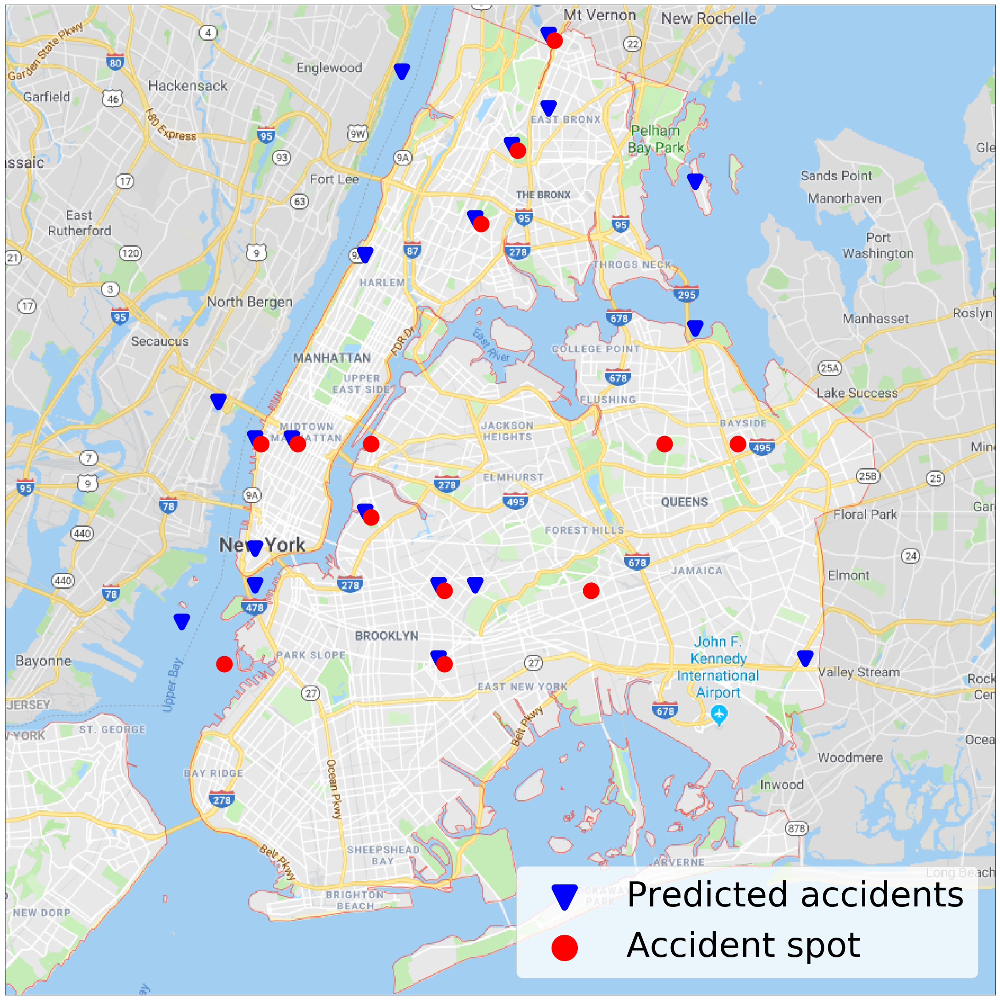

0.6153846153846154 0.7692307692307693


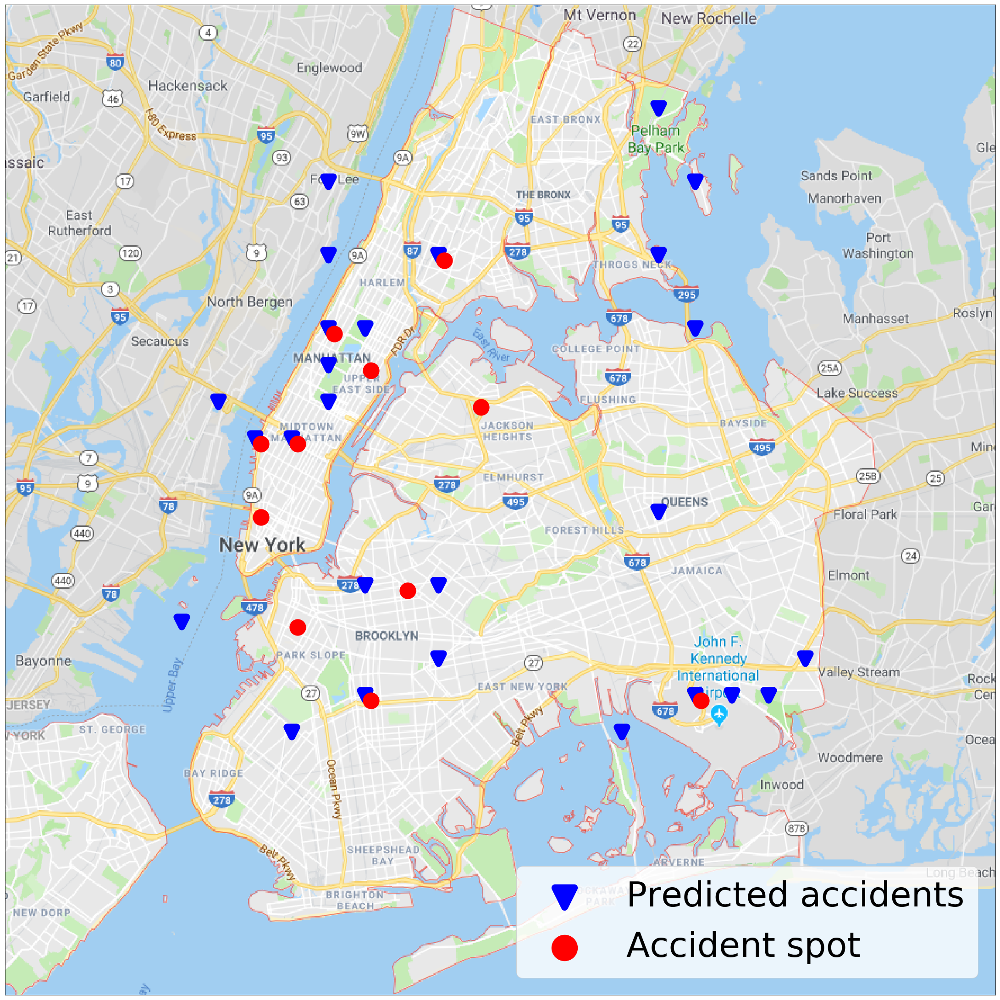

0.5454545454545454 0.7272727272727273


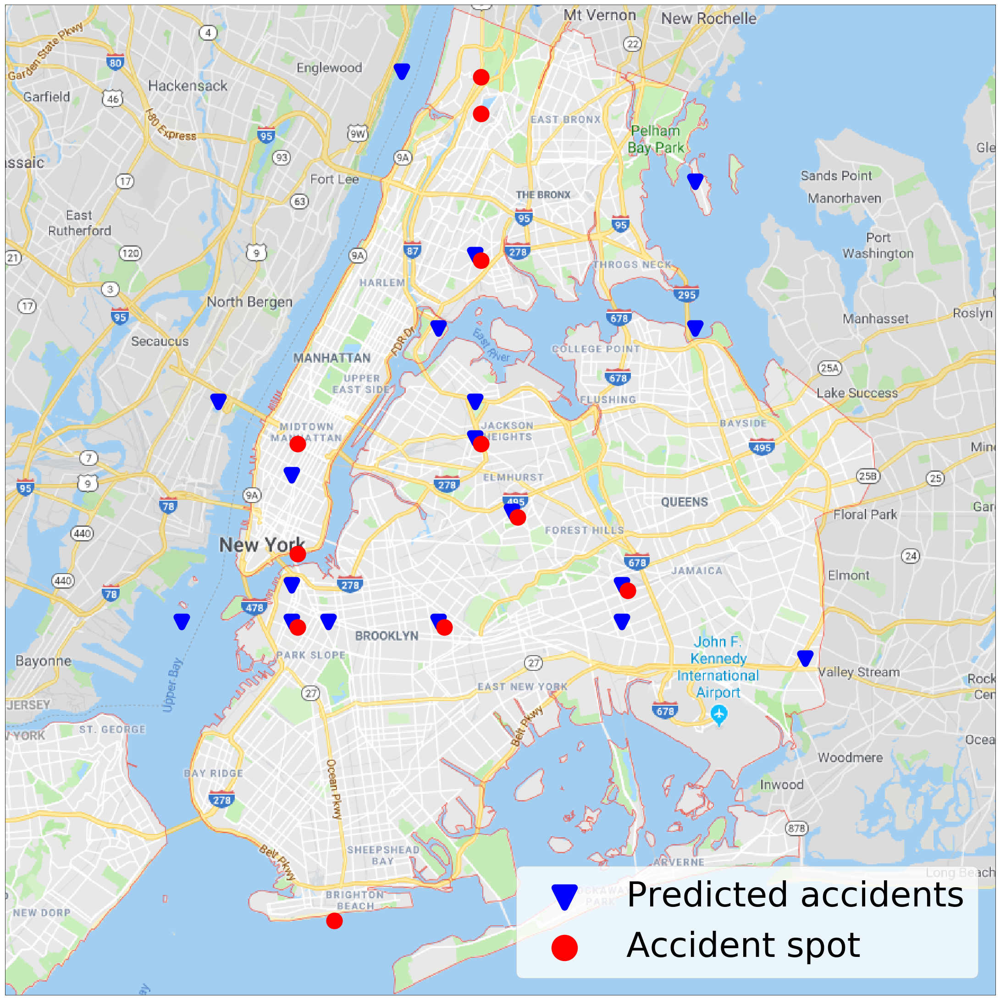

0.5454545454545454 0.8181818181818182


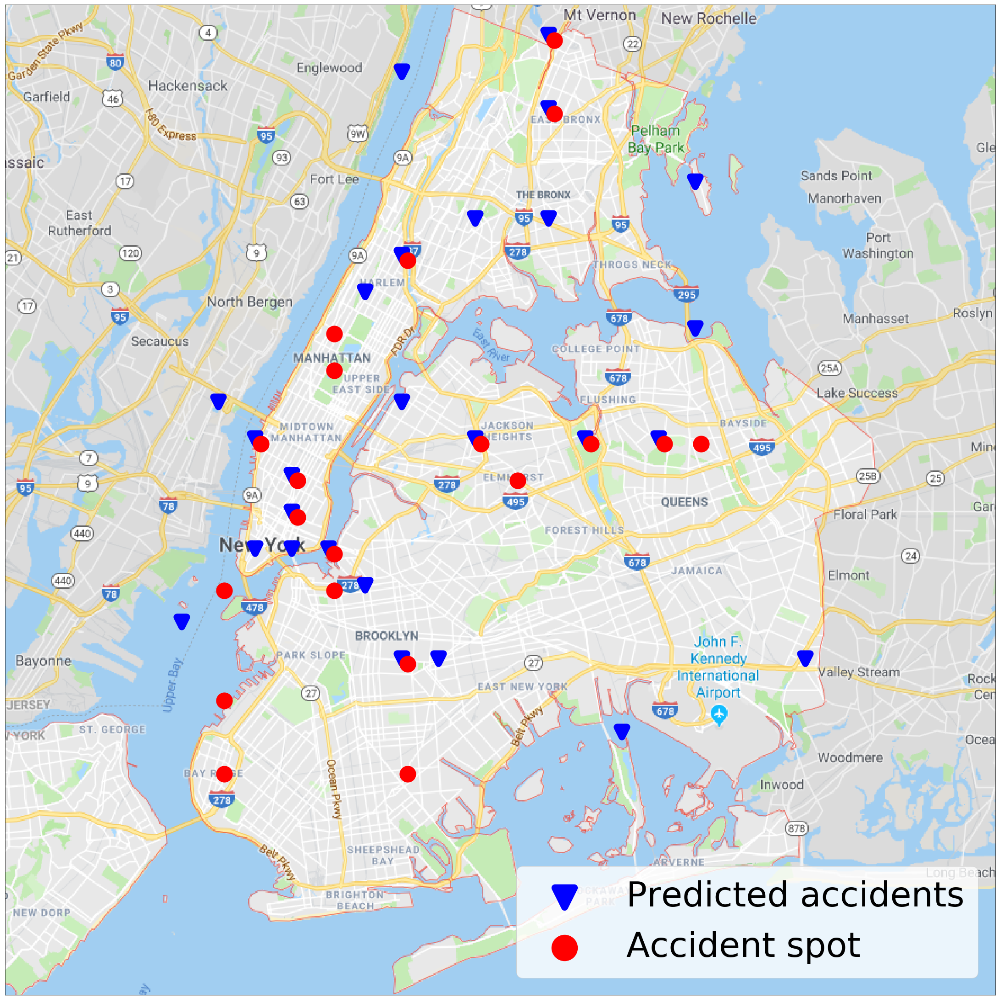

0.55 0.6


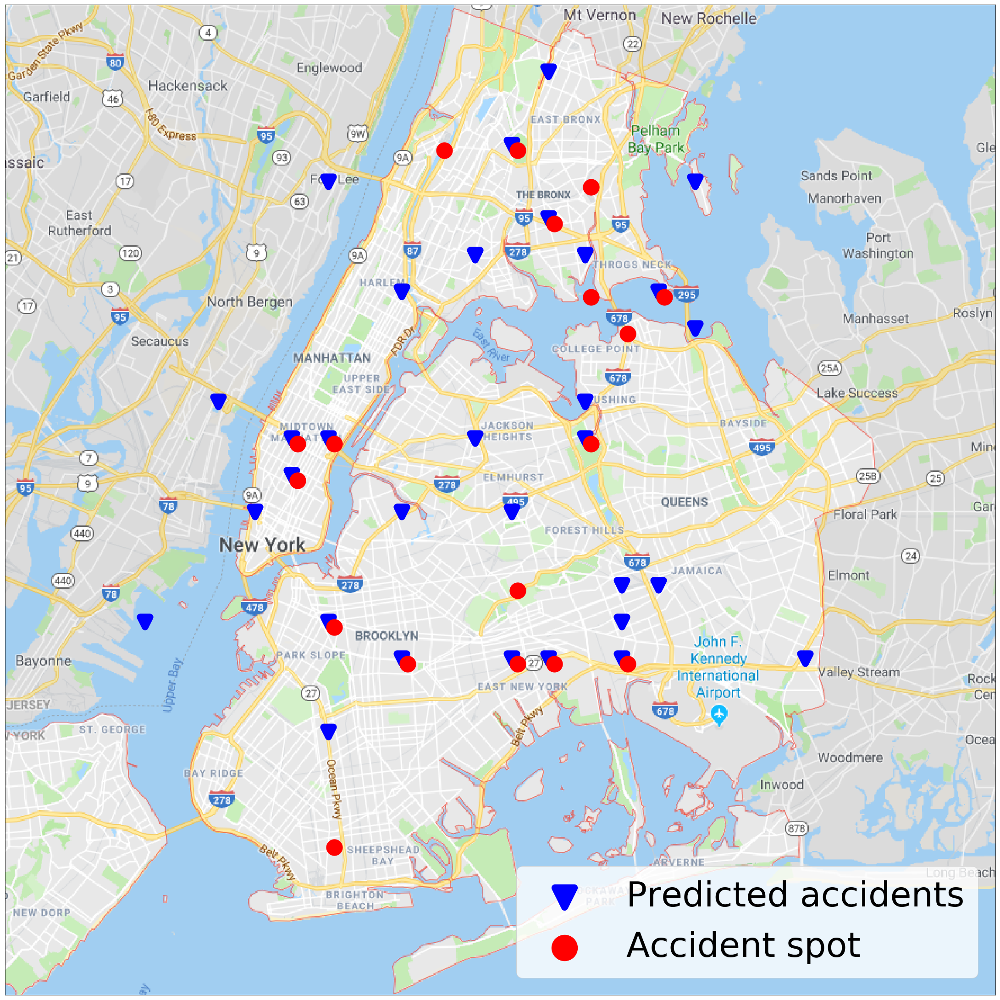

0.6666666666666666 0.5555555555555556


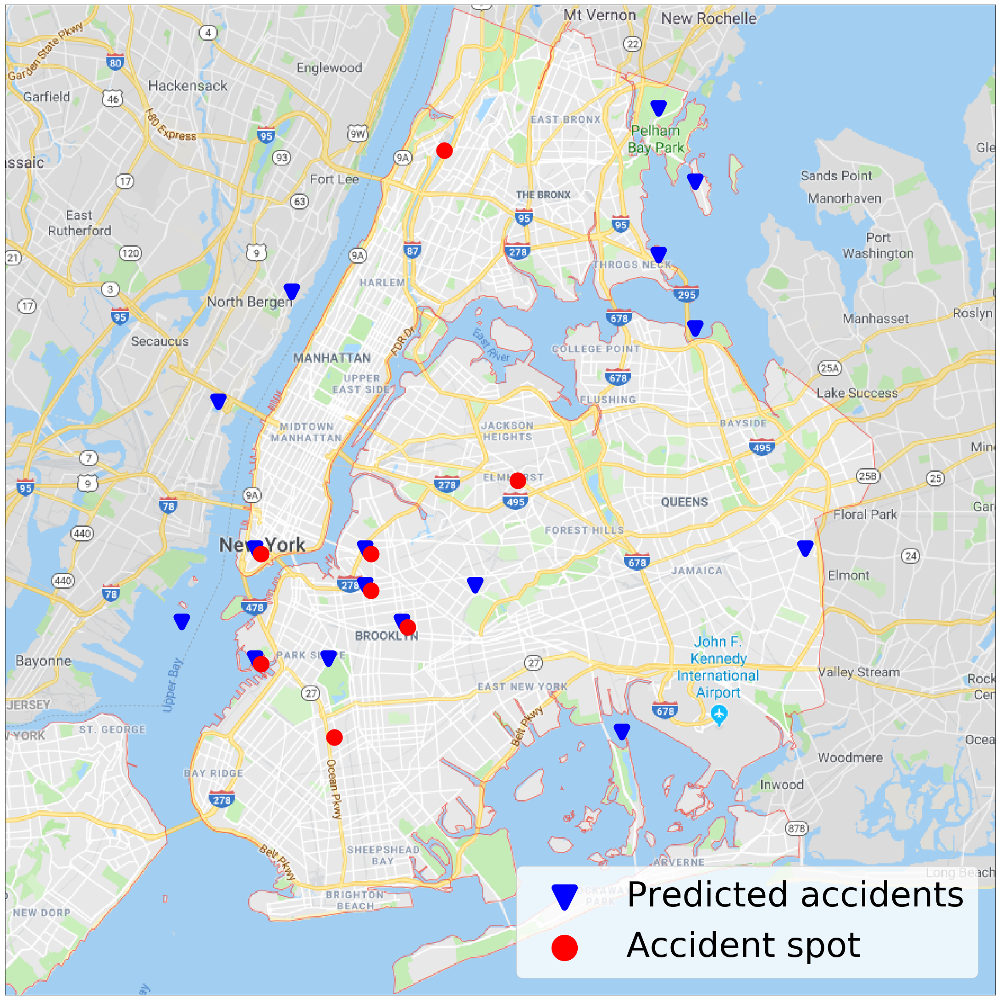

0.625 1.0


In [136]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from  numpy import *


count1=0
count2=0
Count=0
Acc1=0
Acc2=0
C=0
C1=0
C2=0
Total_time = 1
Dim_o3 = 18
Record=[]
test_num = len(Predicted_results_1task)

Task_1 = np.load('GCN_results_07/task_1_0814_4800_100_18_9L_456_'+str(NUM)+'.npy') 

Predicted_results_3task = np.load('train_data_1210/true_labels_3.npy')
Task_3 = Predicted_results_3task.reshape([test_num,1,18,1])


###--------- 画图用的-----------------##########
a=[]
bias=10
for i in range(1,28):
    for j in range(1,28):
        a.append([16.3+32.59*(j-1)+bias,16.3+32.59*(i-1)+bias])
Fig_size = 30
rect=[0,0,1,1]        

scatterMarkers=['s','o','^','8','p','d','v','h','>','<']
axprops=dict(xticks=[],yticks=[])
imgP = plt.imread('NYC_pic_raw.bmp')
###--------- 画图用的 over-----------------##########

######----------开始提名，排序-----------------------#########
for mm in range(0,18):
    count1=0
    count2=0
    Count=0
    A_risk=np.zeros([Cluster_results.shape[0],Cluster_results.shape[1]])
    for i in range(Dim_o3):
        for j in range(np.flatnonzero(Cluster_results[i]).shape[0]):
            if Cluster_results[i,j]!=0:
                #print(Cluster_results4[i,j])
                A_risk[i,j]=Task_1[mm,0,Cluster_results[i,j],0]

    risk_index=[]
    for i in range(Dim_o3):
        k=np.int16(Task_3[mm,0,i,0])
        #print("k:",k)
        Sort1=np.array(-A_risk[i,0:np.flatnonzero(Cluster_results[i]).shape[0]]).argsort()
        #print(Sort1)
        if (k>=2):
            #print(i,Sort1)
            SS=Sort1[0:k]
            risk_index.append(list(SS))
        if (k<=1): #只要k小于等于1则用这个方法
            risk_index.append([Sort1[-1]])
    #print(risk_index)
    #由cluster的索引号映射回原来的ID
    Highrisk_ID=[]
    for i in range(Dim_o3):
        #print("risk_index[i]:",risk_index[i])
        if  len(risk_index[i])>2:
            for kk in risk_index[i]:
                if Cluster_results[i,np.int(kk)]<=271:
                    Highrisk_ID.append(Cluster_results[i,np.int(kk)])
                #print(1,i,np.int(kk))
        if len(risk_index[i])<=1:
            if (risk_index[i][0]!=-1) and (Cluster_results[i,int(risk_index[i][0])]<271):
                Highrisk_ID.append(Cluster_results[i,int(risk_index[i][0])])
    #print(Highrisk_ID)
#############-----------画图——----------------------#########
    Points=[]
    B=[]
    A=Highrisk_ID
    for i in range(len(A)):
       B.append(index_road[A[i],0]) 
    for j in list(B):
        Points.append(a[j])

    Points_GT=[]
    GT= np.where(true_labels[mm,:,0]>0)[0]
    GT_0=[]
    for i in range(len(GT)):
       GT_0.append(index_road[GT[i],0]) 
    for j in list(GT_0):
        Points_GT.append(a[j])
    Points_GT=np.array(Points_GT)+5
    datMat=mat(Points)
    datMat2=mat(Points_GT)
    fig=plt.figure(figsize=(Fig_size,Fig_size))
    ax0 = fig.add_axes(rect,label='ax0',**axprops)

    ax0.imshow(imgP)   #背景图片
    ax0.scatter(datMat[:,0].flatten().A[0],datMat[:,1].flatten().A[0],label="Predicted accidents",marker='v',s=Fig_size*15,linewidths=Fig_size/2,c='b')
    ax0.scatter(datMat2[:,0].flatten().A[0],datMat2[:,1].flatten().A[0],label="Accident spot",marker='o',s=Fig_size*15,linewidths=Fig_size/2,c='r')
    plt.legend(loc="lower right",markerscale=2.,numpoints=2,scatterpoints=1,fontsize=Fig_size*2.5)
    #plt.show() 
    plt.show()    

#############-----------画图完——----------------------#########  
    #直接预测
    Acc_sum_no=20
    #print("Acc_sum_no:",Acc_sum_no)
    Pred=(-Task_1[mm,0,:,0]).argsort()[0:Acc_sum_no]
    #pred_1=list(set(np.array(Highrisk_ID)+1).union(set(np.array(Highrisk_ID)-1)))
    #Highrisk_ID=list(set(pred_1).union(set(Highrisk_ID)))
    Real=list(np.where(true_labels[mm,:,0]>0)[0])
    predict_Hier=list(set(Highrisk_ID).intersection(set(list(Real))))#交集
    predict_Direct=list(set(Pred).intersection(set(Real)))#交集
    Count=np.array(Real).shape[0]
    count1=np.array(predict_Hier).shape[0]
    count2=np.array(predict_Direct).shape[0]
    if count1==0:
        continue
    acc1=1.00*count1/Count
    acc2=1.00*count2/Count
    C=C+Count
    C1=C1+count1
    C2=C2+count2
    Acc1=Acc1+acc1
    Acc2=Acc2+acc2
    print(acc1,acc2)



